In [1]:
import os
from glob import glob
import numpy as np
import dask
import xarray as xr
from dask import compute, delayed
from matplotlib import pyplot as plt
%matplotlib inline

from mitequinox.utils import *

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.6/site-packages/cmocean/tools.py:76: MatplotlibDeprecationWarning: The is_string_like function was deprecated in version 2.1.
  if not mpl.cbook.is_string_like(rgbin[0]):


In [2]:
from dask_jobqueue import PBSCluster
local_dir = os.getenv('TMPDIR')
cluster = PBSCluster(local_directory=local_dir)
#print(cluster.job_script())
w = cluster.start_workers(30)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.6/site-packages/distributed/utils.py:128: RuntimeWarning: Couldn't detect a suitable IP address for reaching '8.8.8.8', defaulting to '127.0.0.1': [Errno 101] Network is unreachable
  % (host, default, e), RuntimeWarning)


In [3]:
# get dask handles and check dask server status
from dask.distributed import Client
client = Client(cluster)

In [4]:
client

Client Scheduler: tcp://10.148.1.23:58862 Dashboard: http://10.148.1.23:8787/status,Cluster Workers: 60 Cores: 240 Memory: 3000.00 GB


# Zarr data_each hour

In [5]:
data_dir = '/home1/scratch/xyu/mit_zarr/'

In [6]:
D = [xr.open_zarr(data_dir+'Eta/Eta_t%04d.zarr'%(t), decode_cf=False) for t in range(3)]
ds_Eta = xr.concat(D, dim='time')
vdrop = ['CS','SN','dtime']
ds_Eta = ds_Eta.drop(vdrop)

D = [xr.open_zarr(data_dir+'SSU/SSU_t%04d.zarr'%(t), decode_cf=False) for t in range(3)]
ds_SSU = xr.concat(D, dim='time')
vdrop = ['dtime']
ds_SSU = ds_SSU.drop(vdrop)

D = [xr.open_zarr(data_dir+'SSV/SSV_t%04d.zarr'%(t), decode_cf=False) for t in range(3)]
ds_SSV = xr.concat(D, dim='time')
vdrop = ['dtime']
ds_SSV = ds_SSV.drop(vdrop)

grid = xr.open_zarr('/home1/scratch/xyu/mit_grid.zarr')


In [7]:
%time ds = xr.merge([ds_Eta, ds_SSU, ds_SSV, grid])
print(ds)
print('\n data size: %.1f GB' %(ds.nbytes / 1e9))

CPU times: user 8 ms, sys: 0 ns, total: 8 ms
Wall time: 3.96 ms
<xarray.Dataset>
Dimensions:  (face: 13, i: 4320, i_g: 4320, j: 4320, j_g: 4320, time: 3)
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * time     (time) float64 5.702e+06 5.706e+06 5.71e+06
  * i_g      (i_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 ...
  * j_g      (j_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 ...
    CS       (face, j, i) float32 dask.array<shape=(13, 4320, 4320), chunksize=(1, 432, 432)>
    Depth    (face, j, i) float32 dask.array<shape=(13, 4320, 4320), chunksize=(1, 432, 432)>
    SN       (face, j, i) float32 dask.array<shape=(13, 4320, 4320), chunksize=(1, 432, 432)>
    XC       (face, j, i) float32 dask.array<shape=(13, 4320, 4320), chunksize=(1, 432, 432)>
    XG       (face, j_g, i_

In [8]:
def quick_llc_plot(data, axis_off=False, **kwargs):
    face_to_axis = {0: (2, 0), 1: (1, 0), 2: (0, 0),
                    3: (2, 1), 4: (1, 1), 5: (0, 1),
                    7: (0, 2), 8: (1, 2), 9: (2, 2),
                    10: (0, 3), 11: (1, 3), 12: (2, 3)}
    transpose = [7, 8, 9, 10, 11, 12]
    gridspec_kw = dict(left=0, bottom=0, right=4, top=4, wspace=0, hspace=0)
    fig, axes = plt.subplots(nrows=3, ncols=4, gridspec_kw=gridspec_kw)
    for face, (j, i) in face_to_axis.items():
        data_ax = data.isel(face=face)
        ax = axes[j,i]
        yincrease = True
        if face in transpose:
            data_ax = data_ax.transpose()
            yincrease = False
        data_ax.plot(ax=ax, yincrease=yincrease, **kwargs)
        if axis_off:
            ax.axis('off')
        ax.set_title('')

In [9]:
import xgcm

grid = xgcm.Grid(ds, periodic=['X', 'Y'])
grid

<xgcm.Grid>
X Axis (periodic):
  * center   i (4320) --> left
  * left     i_g (4320) --> center
Y Axis (periodic):
  * center   j (4320) --> left
  * left     j_g (4320) --> center

# Rotation

## 1. d_Eta/dx and d_Eta/dy

In [10]:
dEta_dx = grid.diff(ds['Eta'],'X').load()
dEta_dy = grid.diff(ds['Eta'],'Y').load()

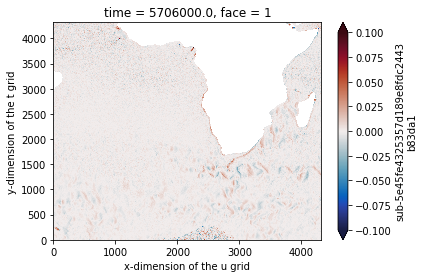

In [28]:
dEta_dx.isel(face=1, time=1).plot(vmin=-0.1, vmax=0.1, cmap = cm.balance)

distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.1.23:53221 remote=tcp://10.148.1.23:48244>
distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.1.23:53222 remote=tcp://10.148.1.23:48244>


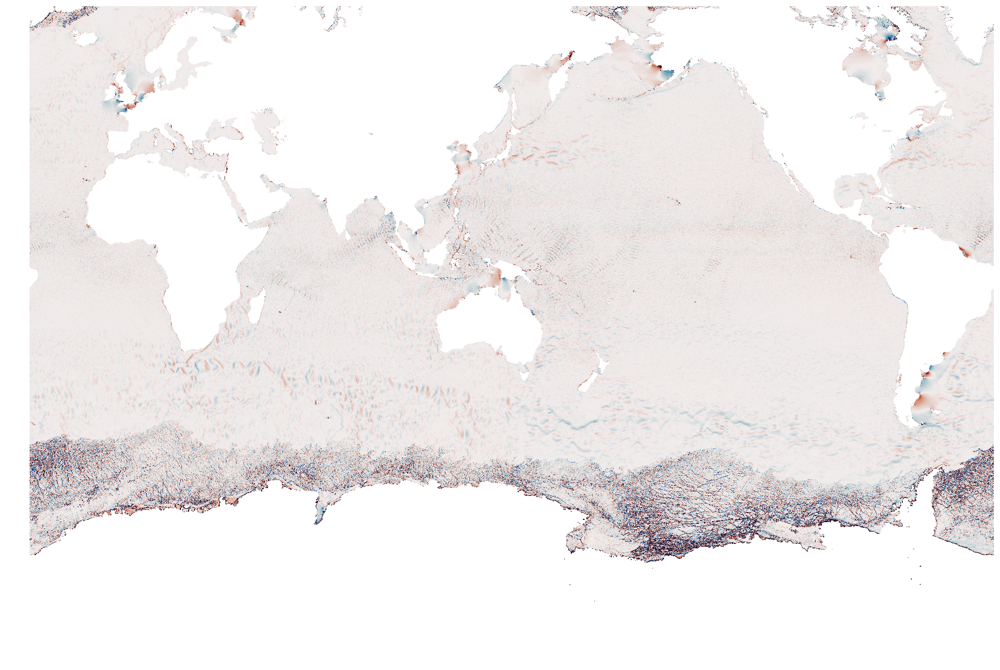

In [21]:
quick_llc_plot(dEta_dx.isel(time=1), vmin=-.1, vmax=.1, add_colorbar=False, axis_off=True, cmap = cm.balance)

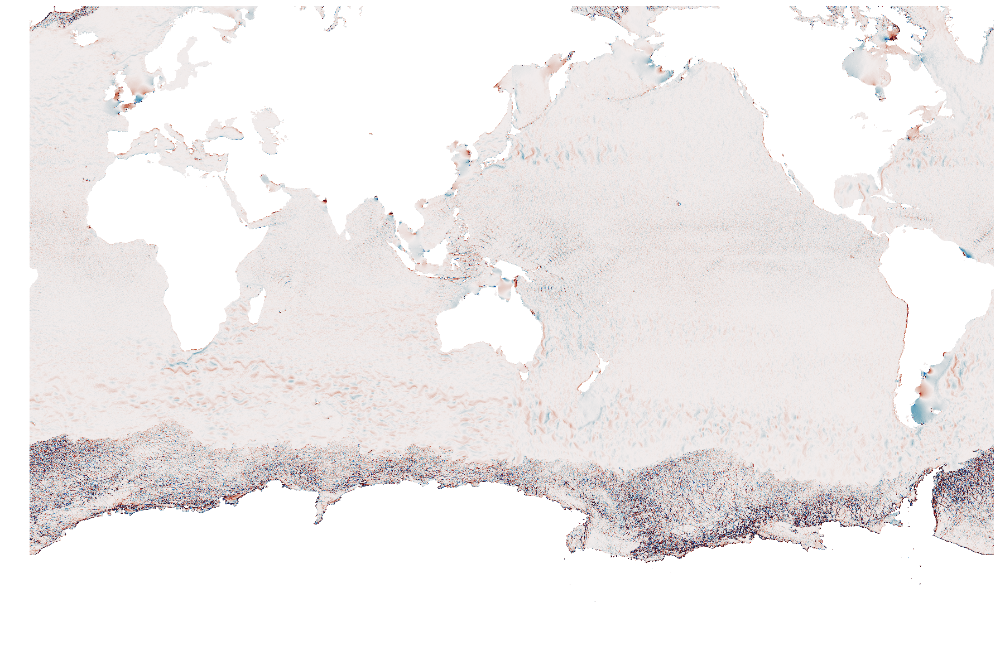

In [11]:
quick_llc_plot(dEta_dy.isel(time=1), vmin=-.1, vmax=.1, add_colorbar=False, axis_off=True, cmap = cm.balance)

In [12]:
dEta_dx_ij = grid.interp(dEta_dx,'X')
dEta_dy_ij = grid.interp(dEta_dy,'Y')
dEta_dx_rotation =  dEta_dx_ij*ds.CS - dEta_dy_ij*ds.SN
dEta_dy_rotation =  dEta_dx_ij*ds.SN + dEta_dy_ij*ds.CS
dEta_dx_new = grid.interp(dEta_dx_rotation,'X').load()
dEta_dy_new = grid.interp(dEta_dy_rotation,'Y').load()

distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.1.23:57510 remote=tcp://10.148.1.23:58862>
distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.1.23:57511 remote=tcp://10.148.1.23:58862>


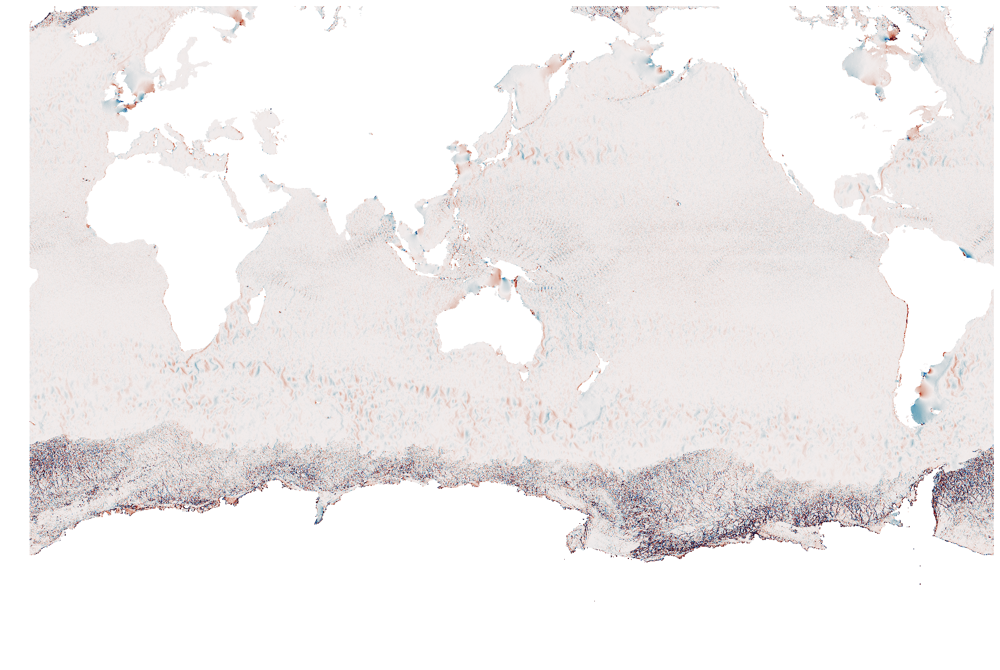

In [13]:
quick_llc_plot(dEta_dx_new.isel(time=1), vmin=-.1, vmax=.1, add_colorbar=False, axis_off=True, cmap = cm.balance)

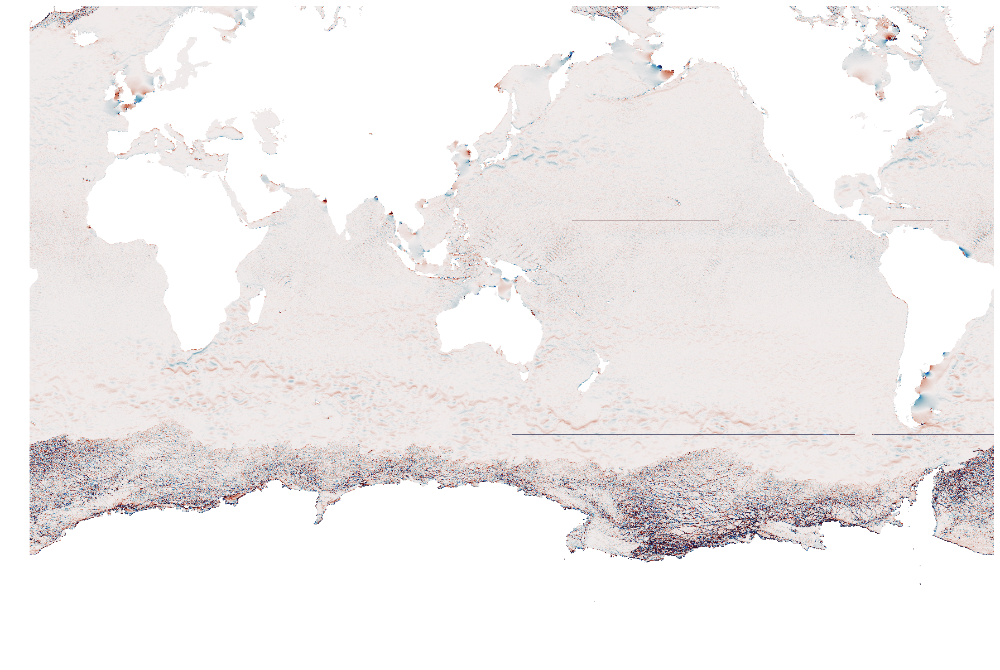

In [14]:
quick_llc_plot(dEta_dy_new.isel(time=1), vmin=-.1, vmax=.1, add_colorbar=False, axis_off=True, cmap = cm.balance)

# 2. du/dx and dv/dy

## 2.1 compute du/dx and dv/dy and then rotate

In [15]:
dSSU_dx = grid.diff(ds['SSU'],'X').load()
dSSV_dy = grid.diff(ds['SSV'],'Y').load()

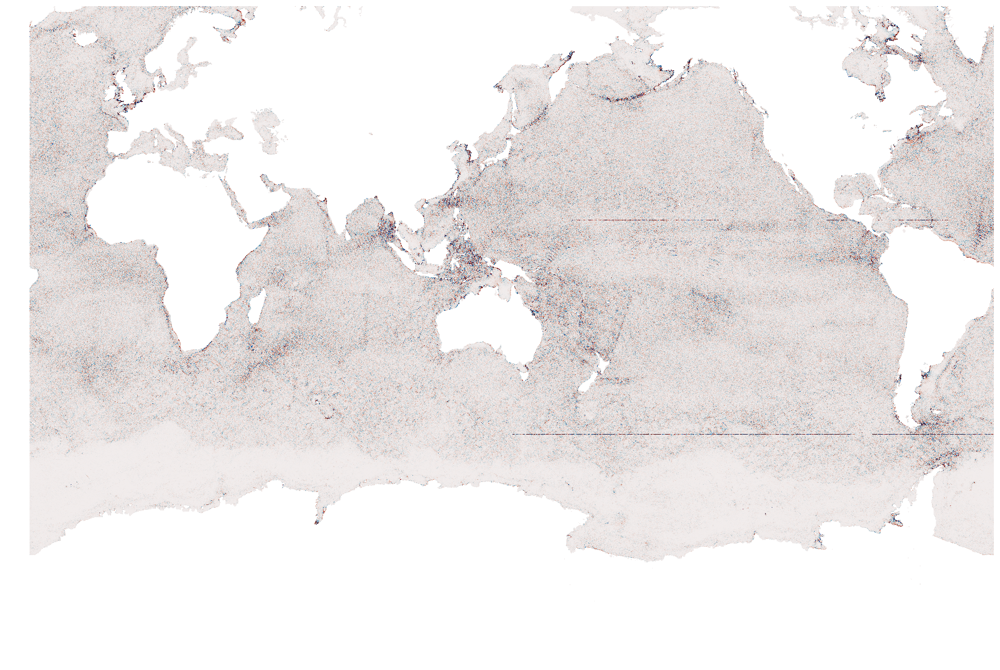

In [16]:
quick_llc_plot(dSSU_dx.isel(time=1), vmin=-.2, vmax=.2, add_colorbar=False, axis_off=True, cmap = cm.balance)

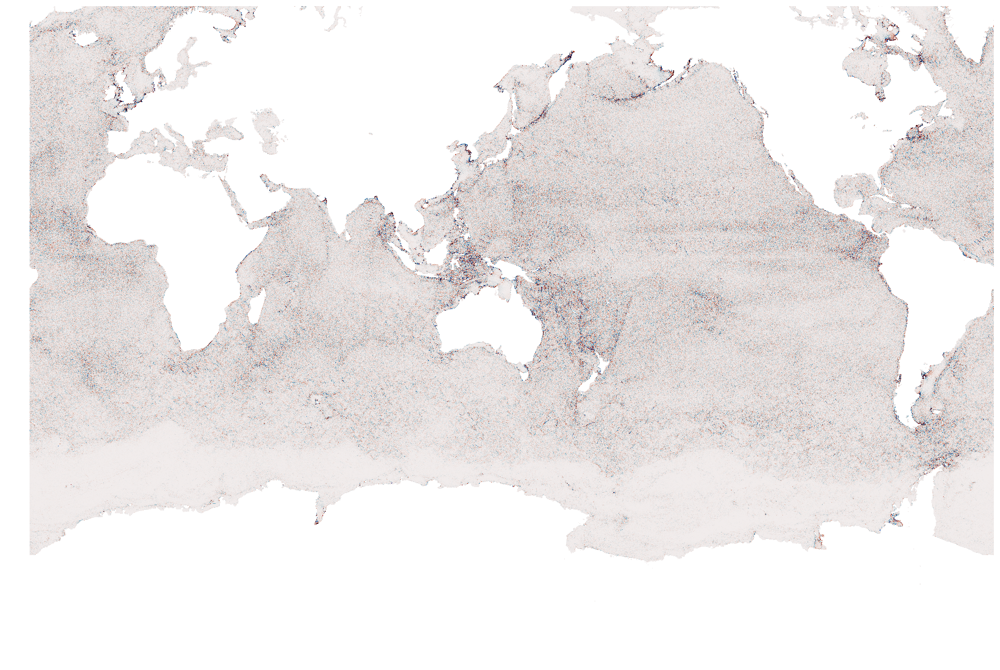

In [18]:
quick_llc_plot(dSSV_dy.isel(time=1), vmin=-.2, vmax=.2, add_colorbar=False, axis_off=True, cmap = cm.balance)

In [21]:
dSSU_dx_rotation =  (dSSU_dx*ds.CS - dSSV_dy*ds.SN).load()
dSSV_dy_rotation =  (dSSU_dx*ds.SN + dSSV_dy*ds.CS).load()

distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)


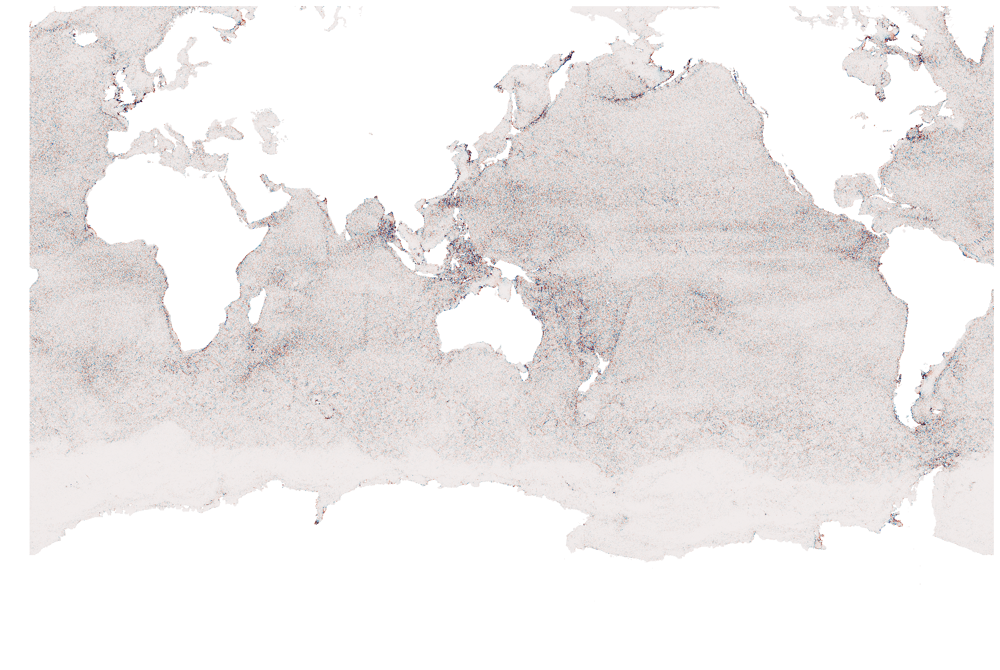

In [22]:
quick_llc_plot(dSSU_dx_rotation.isel(time=1), vmin=-.2, vmax=.2, add_colorbar=False, axis_off=True, cmap = cm.balance)

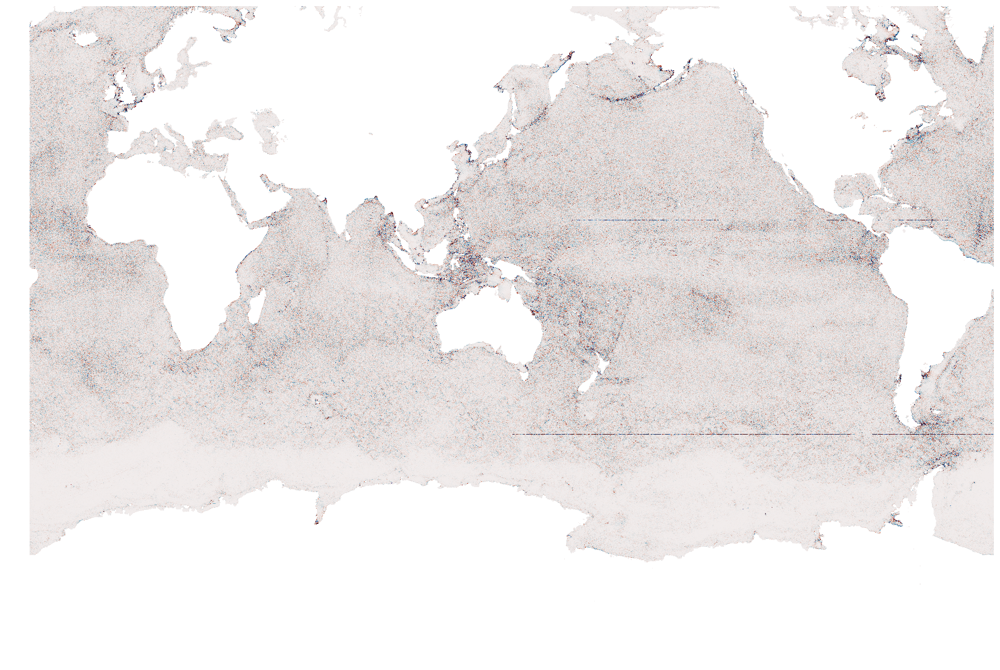

In [24]:
quick_llc_plot(dSSV_dy_rotation.isel(time=1), vmin=-.2, vmax=.2, add_colorbar=False, axis_off=True, cmap = cm.balance)

## 2.2 rotate u and v and then compute du/dx and dv/dy

In [25]:
U_ij = grid.interp(ds['SSU'],'X')
V_ij = grid.interp(ds['SSV'],'Y')
U =  U_ij*ds.CS - V_ij*ds.SN
V =  U_ij*ds.SN + V_ij*ds.CS
U_origin = grid.interp(U,'X')
V_origin = grid.interp(V,'Y')

In [26]:
dSSU_dx_origin = grid.diff(U_origin,'X').load()
dSSV_dy_origin = grid.diff(V_origin,'Y').load()

distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

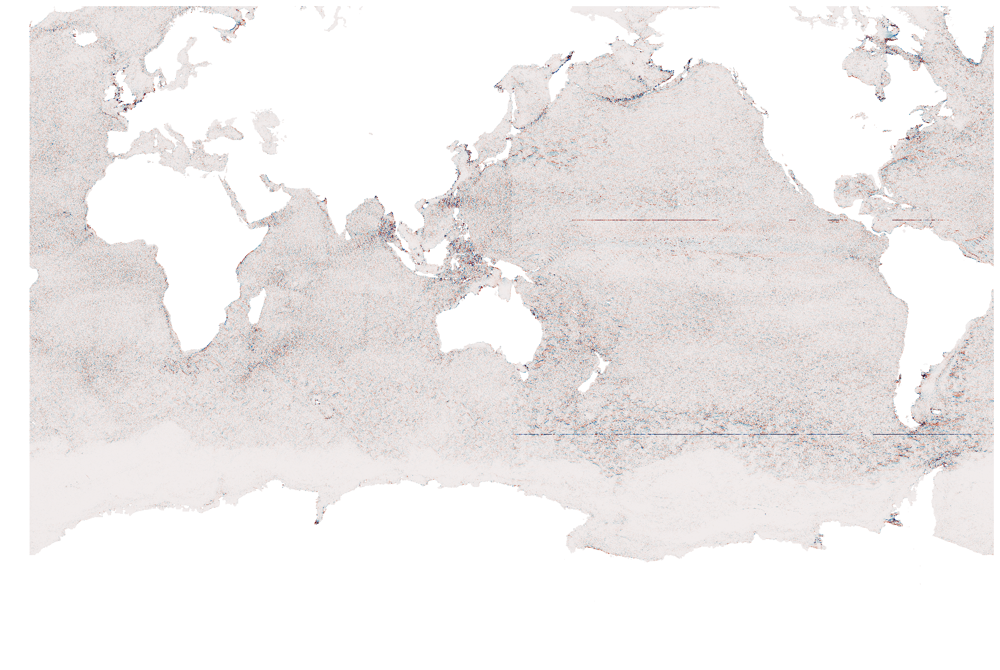

In [27]:
quick_llc_plot(dSSU_dx_origin.isel(time=1), vmin=-.2, vmax=.2, add_colorbar=False, axis_off=True, cmap = cm.balance)

In [ ]:
quick_llc_plot(dSSV_dy_origin.isel(time=1), vmin=-.2, vmax=.2, add_colorbar=False, axis_off=True, cmap = cm.balance)